In [1]:
import pandas as pd
import numpy as np
dftrain = pd.read_csv(r"traindata.csv",encoding='gbk')
dftest = pd.read_csv(r"testdata.csv",encoding='gbk')
y_train = dftrain['PCEbest']
X_train = dftrain.drop(['PCEbest'],axis=1)
y_test = dftest['PCEbest']
X_test = dftest.drop(['PCEbest'],axis=1)

Train R2: 0.4730099827559625
Train RMSE: 3.9663536831450696
Train MAE: 3.075400901747553
Test MAE: 2.801121959261628


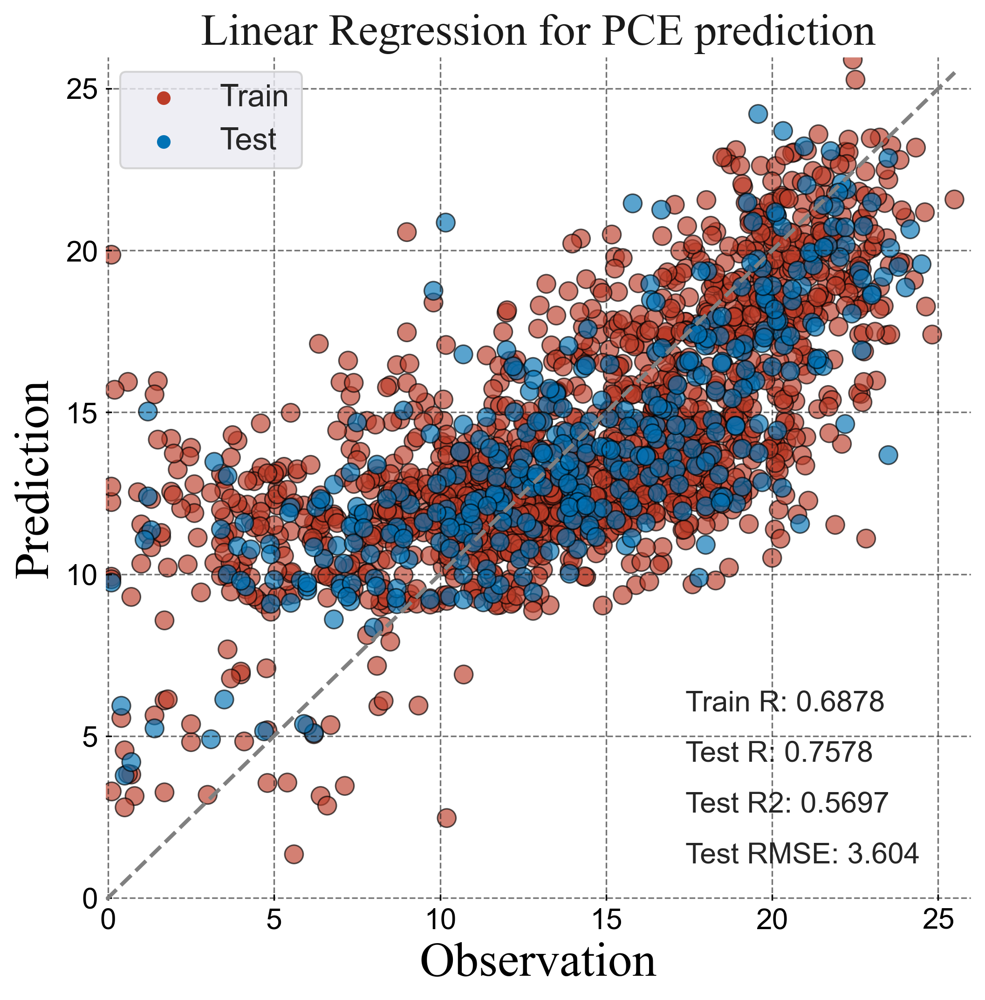

In [2]:
from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor
from letsplot import myscatterplot,save_arrays_with_nan
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import r2_score
import matplotlib.pyplot as plt

# Linear Regression Model

std = StandardScaler()
x_train = std.fit_transform(X_train)
x_test = std.transform(X_test)

lr = LinearRegression()
lr.fit(x_train, y_train)

y_test_hat_lr = lr.predict(x_test)
y_train_hat_lr = lr.predict(x_train)

myscatterplot(y_train, y_train_hat_lr, y_test, y_test_hat_lr, 'Linear Regression', plot_height=8, picname='LR')
# save_arrays_with_nan(y_train.values,y_train_hat_lr,y_test.values,y_test_hat_lr,'LR')

### NNM

d:\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


Train R2: 0.6625361504282168
Train RMSE: 3.1739777060472747
Train MAE: 2.3614187295130944
Test MAE: 2.4818855120552543


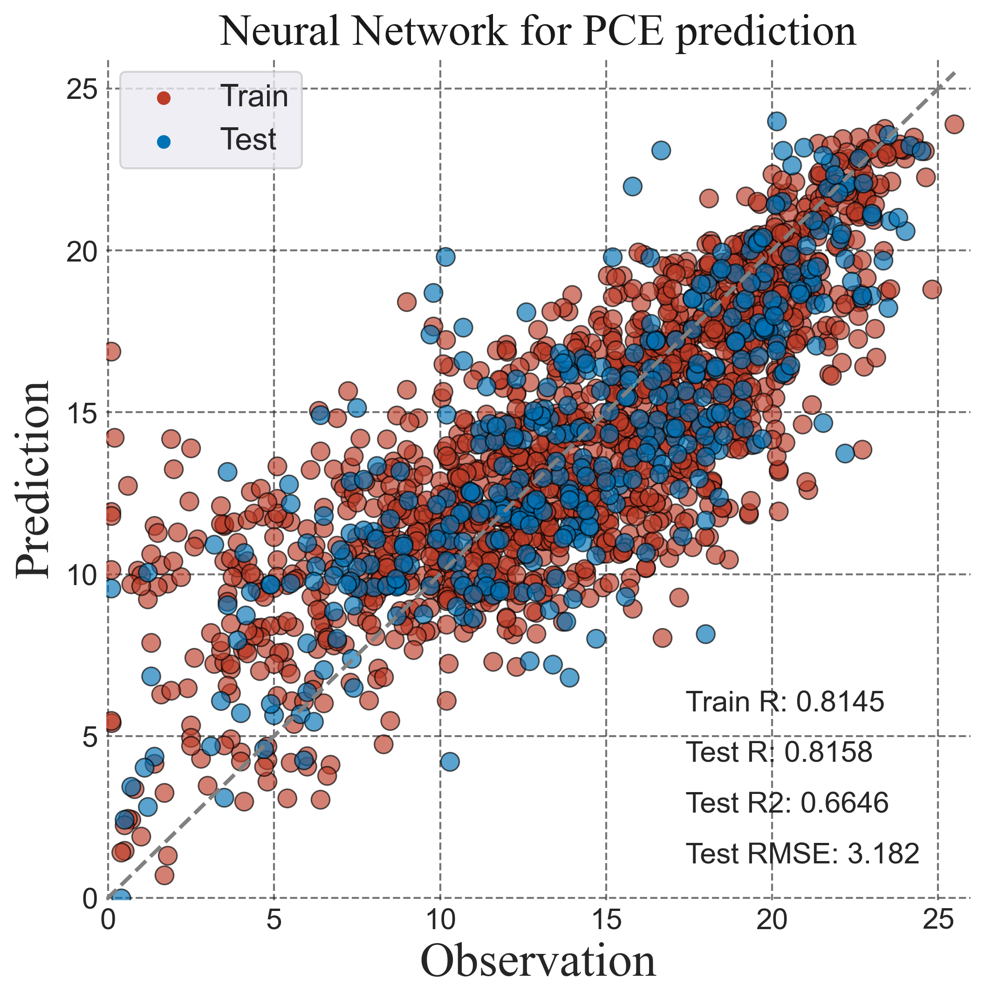

In [3]:
# Neural Network Model
nn = MLPRegressor(hidden_layer_sizes=(100,), max_iter=500, random_state=42)

# std=StandardScaler()
# x_train=std.fit_transform(X_train)
# x_test=std.transform(X_test)

nn.fit(x_train, y_train)
y_test_hat_nn = nn.predict(x_test)
y_train_hat_nn = nn.predict(x_train)
myscatterplot(y_train, y_train_hat_nn, y_test, y_test_hat_nn, 'Neural Network', plot_height=8, picname='NN')

d:\anaconda3\lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:614: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (1000) reached and the optimization hasn't converged yet.
  warnings.warn(


Best parameters: {'activation': 'tanh', 'alpha': 0.01, 'hidden_layer_sizes': (500,), 'learning_rate': 'constant', 'solver': 'sgd'}
Train R2: 0.7690228817852223
Train RMSE: 2.625879078912451
Train MAE: 1.8869096558795087
Test MAE: 2.390186266924029


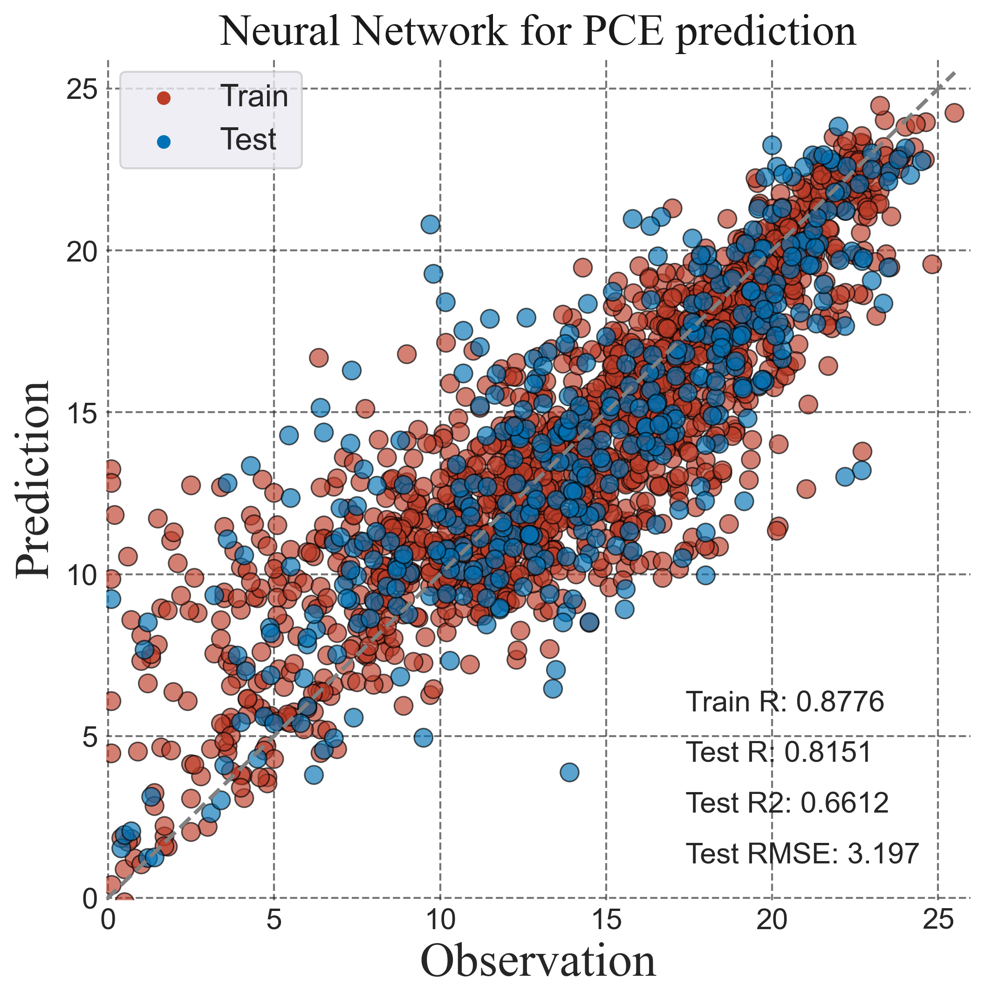

In [4]:
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import GridSearchCV
from letsplot import myscatterplot

# MLPRegressor
param_grid = {
    'hidden_layer_sizes': [(100,), (200,), (500,), (100, 50)],
    'activation': ['tanh', 'relu'],
    'solver': ['adam', 'sgd'],
    'alpha': [0.0001, 0.001, 0.01],
    'learning_rate': ['constant', 'adaptive']
}

nn = MLPRegressor(max_iter=1000, random_state=42)
grid_search_nn = GridSearchCV(estimator=nn, param_grid=param_grid, cv=5, n_jobs=-1)

grid_search_nn.fit(x_train, y_train)

# Get the best model
best_nn = grid_search_nn.best_estimator_
print("Best parameters:", grid_search_nn.best_params_)

y_test_hat_nn = best_nn.predict(x_test)
y_train_hat_nn = best_nn.predict(x_train)

myscatterplot(y_train, y_train_hat_nn, y_test, y_test_hat_nn, 'Neural Network', plot_height=8, picname='NN')
# save_arrays_with_nan(y_train.values,y_train_hat_nn,y_test.values,y_test_hat_nn,'NN')

### SVR

Train R2: 0.5193102711944049
Train RMSE: 3.7881107266893776
Train MAE: 2.752164068647961
Test MAE: 2.630132536322382


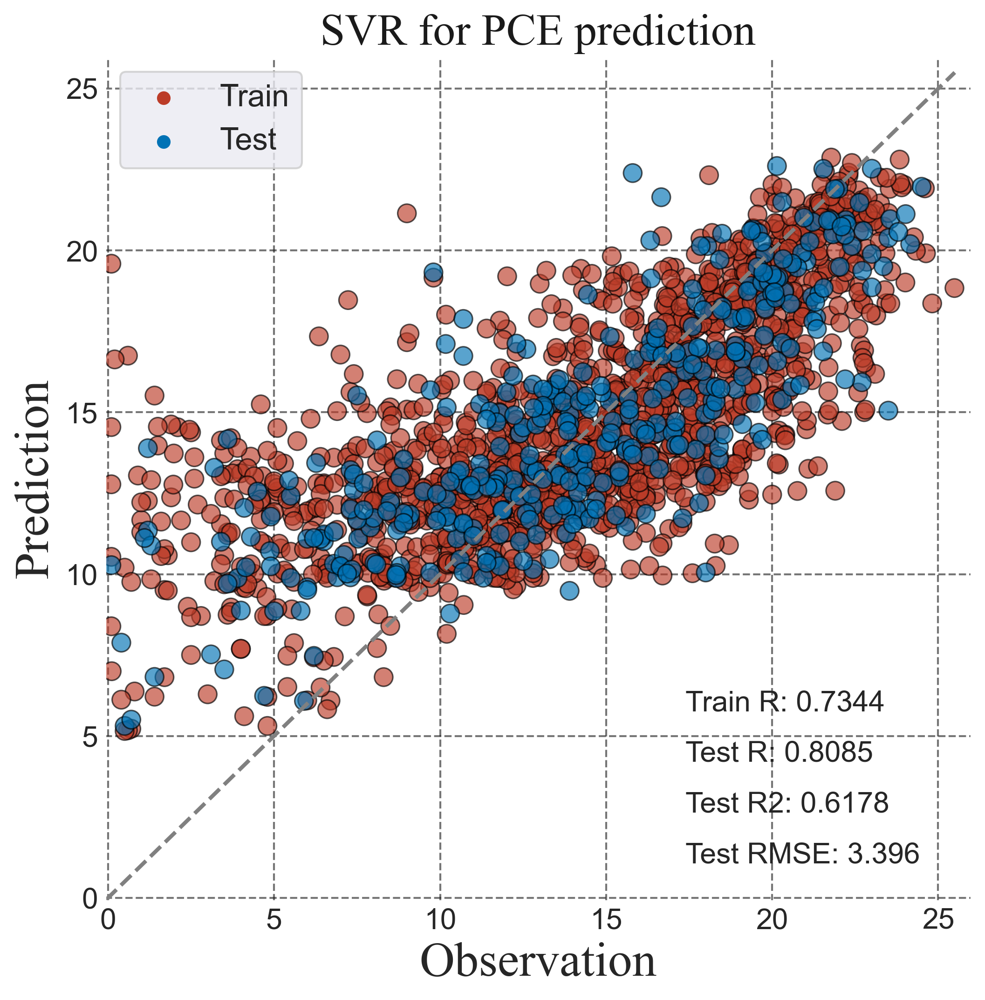

In [5]:
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV
from letsplot import myscatterplot
# Initialize SVR
svr = SVR()
svr.fit(x_train, y_train)

y_test_hat_svr = svr.predict(x_test)
y_train_hat_svr = svr.predict(x_train)

myscatterplot(y_train, y_train_hat_svr, y_test, y_test_hat_svr, 'SVR', plot_height=8, picname='SVR')

Best parameters: {'C': 10, 'degree': 2, 'epsilon': 0.5, 'kernel': 'rbf'}
Train R2: 0.6449078733993423
Train RMSE: 3.2558228380174254
Train MAE: 2.228349174149346
Test MAE: 2.3386057822225115


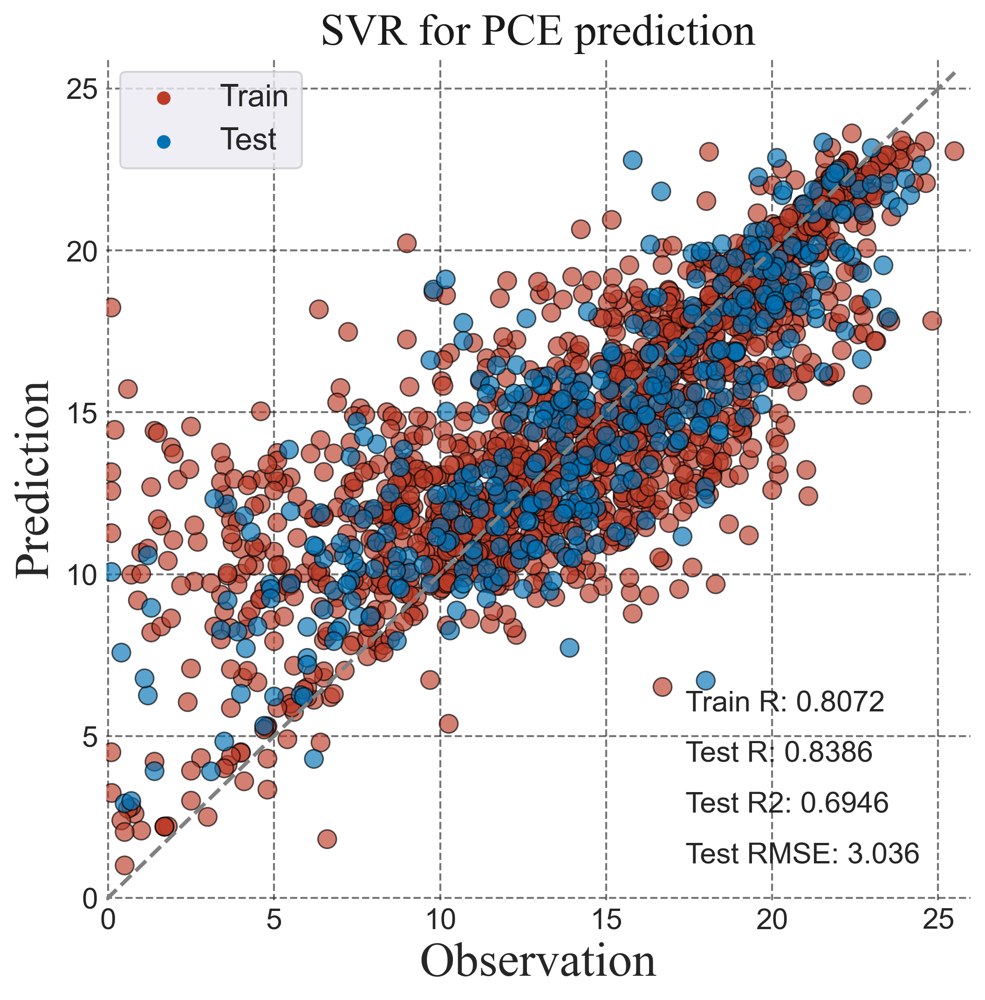

In [6]:
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV
from letsplot import myscatterplot

# SVR
param_grid = {
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'C': [0.1, 1, 10, 100],
    'epsilon': [0.01, 0.1, 0.2, 0.5],
    'degree': [2, 3, 4]  # Only relevant for 'poly' kernel
}


svr = SVR()
grid_search_svr = GridSearchCV(estimator=svr, param_grid=param_grid, cv=5, n_jobs=-1)


grid_search_svr.fit(x_train, y_train)

# Get the best model
best_svr = grid_search_svr.best_estimator_
print("Best parameters:", grid_search_svr.best_params_)


y_test_hat_svr = best_svr.predict(x_test)
y_train_hat_svr = best_svr.predict(x_train)

myscatterplot(y_train, y_train_hat_svr, y_test, y_test_hat_svr, 'SVR', plot_height=8, savepic=False, picname='SVR')
# save_arrays_with_nan(y_train.values,y_train_hat_svr,y_test.values,y_test_hat_svr,'SVR')

### DT

Train R2: 0.9996692435966802
Train RMSE: 0.09936750243632646
Train MAE: 0.0077004313550498305
Test MAE: 2.701404433914069


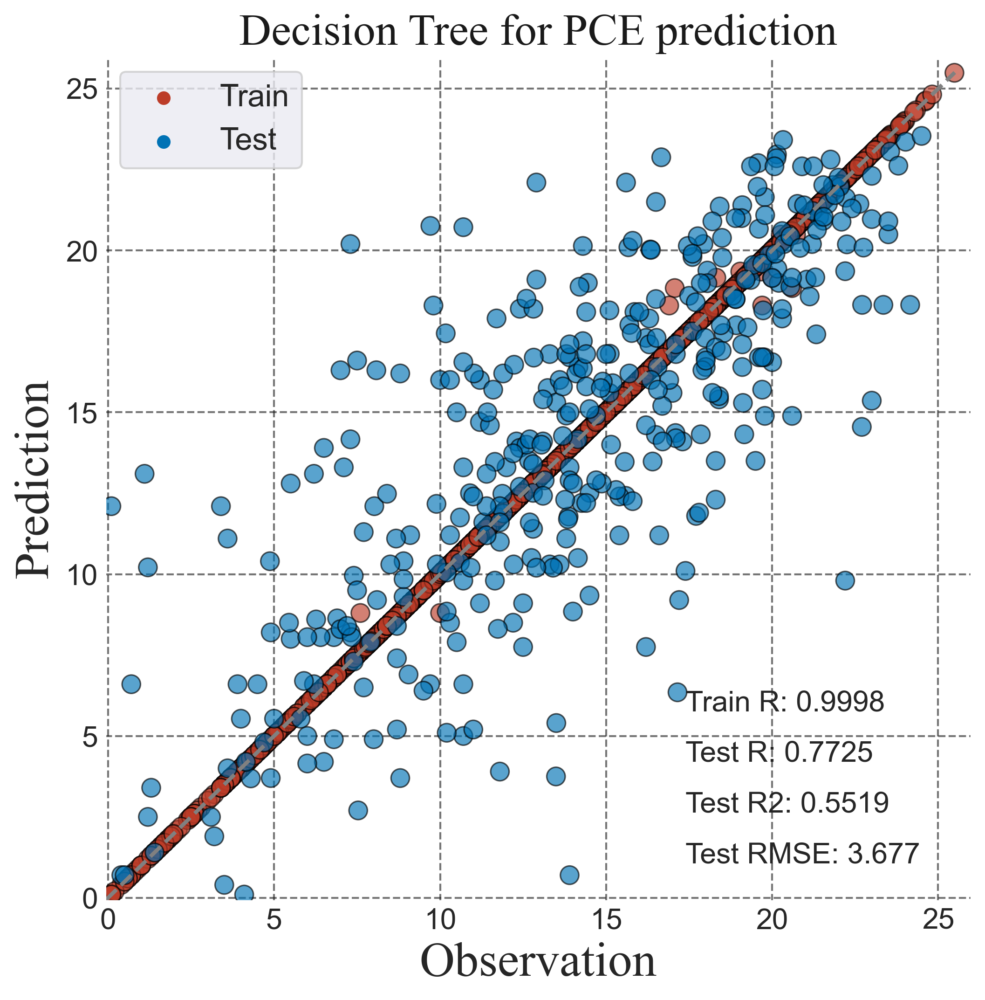

In [7]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
from letsplot import myscatterplot

dt = DecisionTreeRegressor()
dt.fit(X_train, y_train)

y_test_hat_dt = dt.predict(X_test)
y_train_hat_dt = dt.predict(X_train)

myscatterplot(y_train, y_train_hat_dt, y_test, y_test_hat_dt, 'Decision Tree', plot_height=8, picname='DecisionTree')

Best parameters: {'criterion': 'mse', 'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 5, 'splitter': 'best'}
Train R2: 0.7304215809401524
Train RMSE: 2.8368266933710293
Train MAE: 2.113232498345032
Test MAE: 2.690055464847644


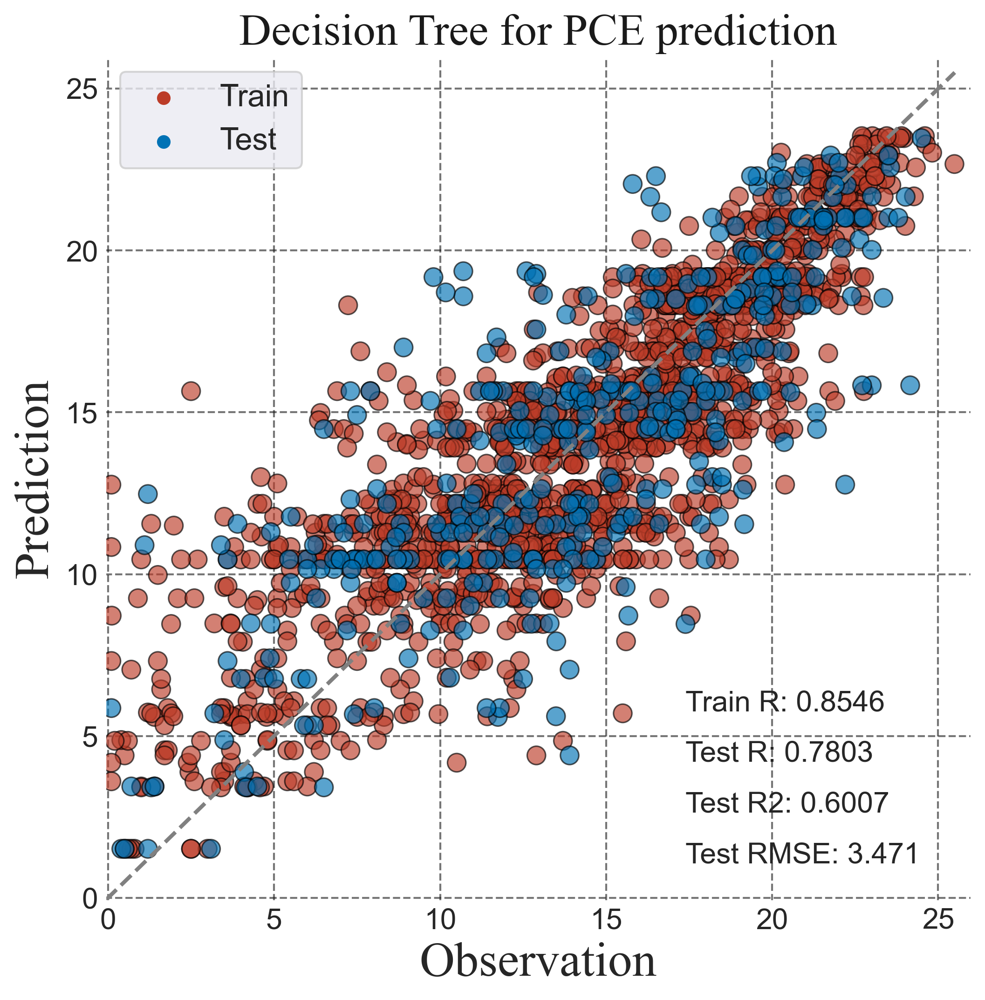

In [8]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
from letsplot import myscatterplot

# DecisionTreeRegressor
param_grid_dt = {
    'criterion': ['mse', 'friedman_mse', 'mae'],
    'splitter': ['best', 'random'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

dt = DecisionTreeRegressor()
grid_search_dt = GridSearchCV(estimator=dt, param_grid=param_grid_dt, cv=5, n_jobs=-1)

grid_search_dt.fit(X_train, y_train)
best_dt = grid_search_dt.best_estimator_

print("Best parameters:", grid_search_dt.best_params_)

y_test_hat_dt = best_dt.predict(X_test)
y_train_hat_dt = best_dt.predict(X_train)
myscatterplot(y_train, y_train_hat_dt, y_test, y_test_hat_dt, 'Decision Tree', plot_height=8, picname='DecisionTree')
# save_arrays_with_nan(y_train.values,y_train_hat_dt,y_test.values,y_test_hat_dt,'DT')

## LGBM

Train R2: 0.8351176367540125
Train RMSE: 2.218591503960486
Train MAE: 1.6597544260597443
Test MAE: 2.222263807423933


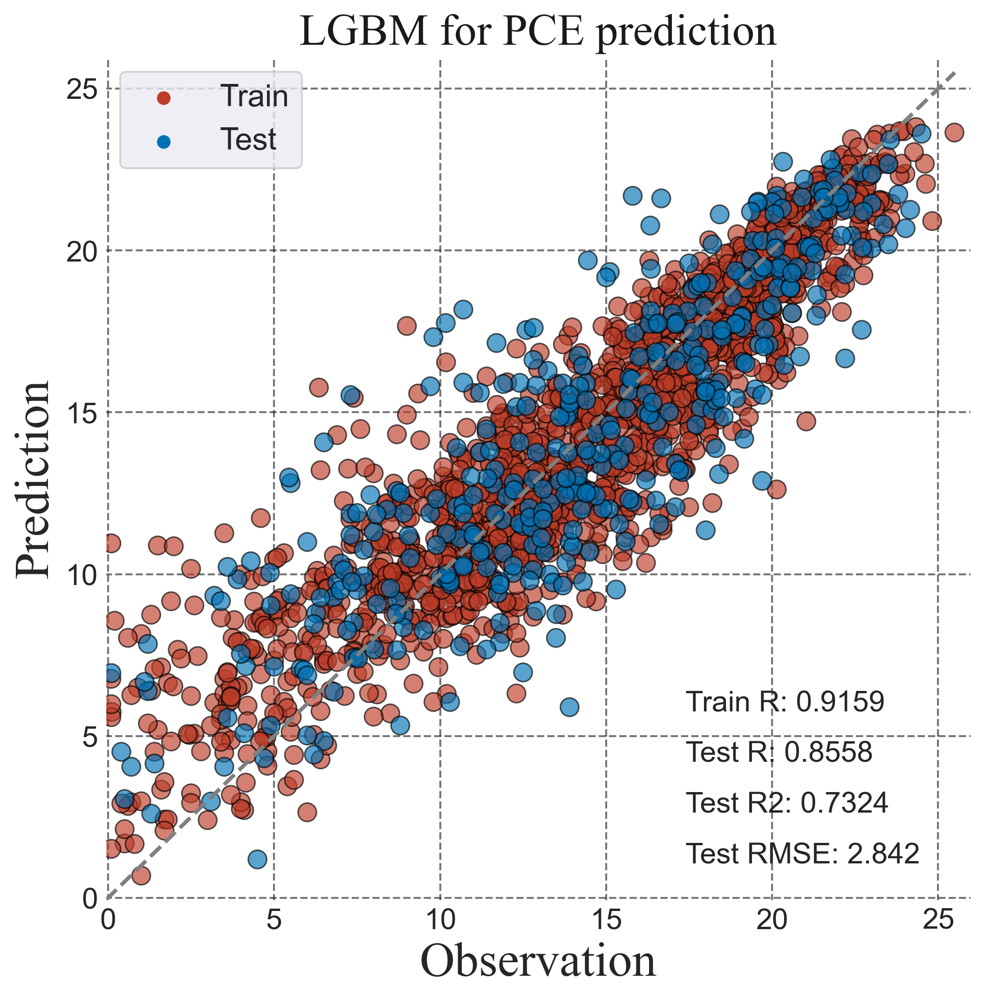

In [9]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from lightgbm import LGBMRegressor
from letsplot import myscatterplot

lgbm = LGBMRegressor(random_state=42)
lgbm.fit(X_train, y_train)
y_test_hat = lgbm.predict(X_test)
y_train_hat = lgbm.predict(X_train)
myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'LGBM',plot_height = 8, picname =  'LGBM')
# save_arrays_with_nan(y_train.values,y_train_hat_svr,y_test.values,y_test_hat_svr,'LGBMbefore')

Best parameters: {'learning_rate': 0.1, 'max_depth': 10, 'n_estimators': 500, 'num_leaves': 10}
Train R2: 0.8443816937790368
Train RMSE: 2.1553638066137006
Train MAE: 1.5847383078637722
Test MAE: 2.159146594600422


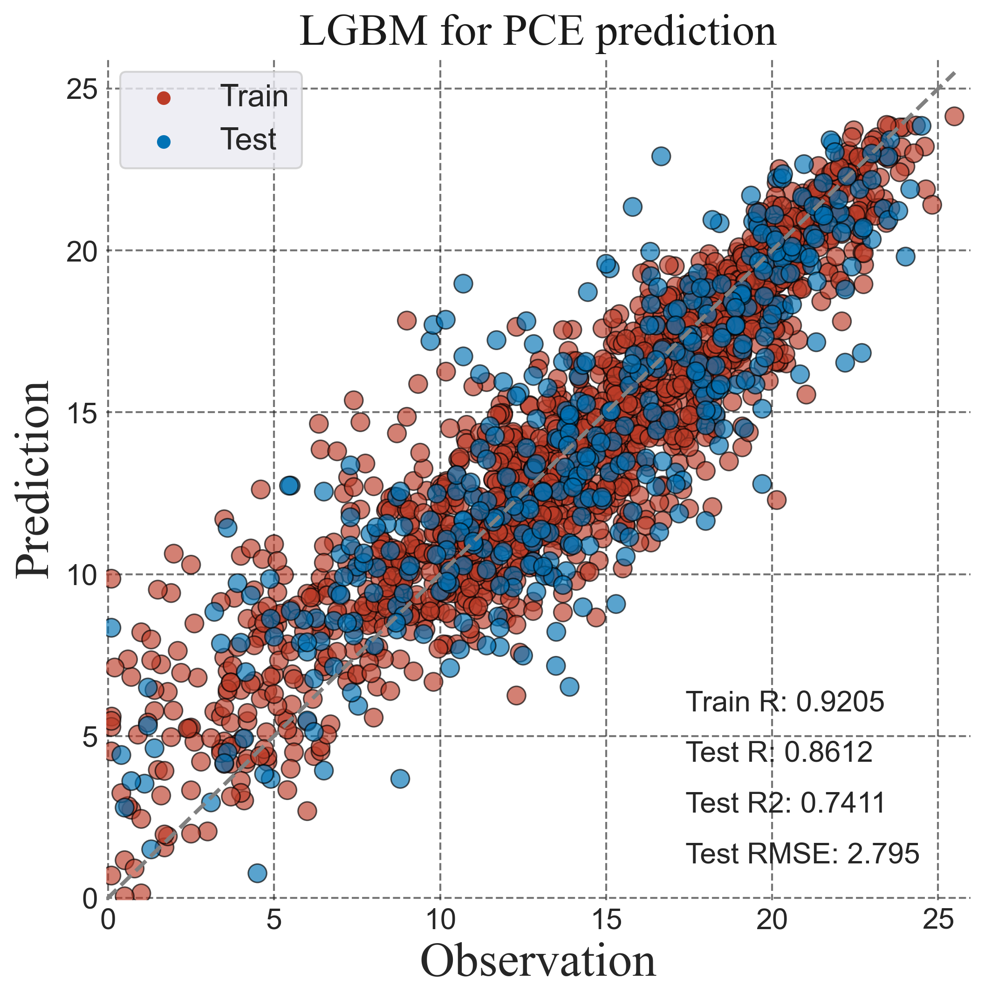

In [10]:
import pandas as pd
from sklearn.model_selection import train_test_split, GridSearchCV
from lightgbm import LGBMRegressor
from letsplot import myscatterplot


lgbm = LGBMRegressor(random_state=42)

param_grid = {
    'n_estimators': [500, 800, 1000],
    'learning_rate': [0.01, 0.1, 0.2],
    'num_leaves': [10, 15],
    'max_depth': [5, 10, None]
}

grid_lgbm = GridSearchCV(estimator=lgbm, param_grid=param_grid, cv=10, scoring='neg_mean_squared_error')
grid_lgbm.fit(X_train, y_train)

print("Best parameters:", grid_lgbm.best_params_)
lgbm = LGBMRegressor(**grid_lgbm.best_params_, random_state=42) 
lgbm.fit(X_train, y_train)

y_test_hat = lgbm.predict(X_test)
y_train_hat = lgbm.predict(X_train)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'LGBM',plot_height = 8, picname =  'LGBM')

In [11]:
# Tree SHAP

import shap
import pandas as pd

X = pd.concat([X_train, X_test], ignore_index=True)
Y = pd.concat([y_train, y_test], ignore_index=True)

def saveimportance(model,name):

    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X)

    feature_importance = pd.DataFrame(abs(shap_values).mean(axis=0), columns=["Feature Importance"])
    feature_importance.index = X.columns
    feature_importance.to_csv("feature_importance({}).csv".format(name))
    shap.summary_plot(shap_values, X, plot_type="bar", show = False)

lgbm = LGBMRegressor(**grid_lgbm.best_params_)
lgbm.fit(X, Y)
# saveimportance(lgbm,'LGBM')

LGBMRegressor(max_depth=10, n_estimators=500, num_leaves=10)

## RF

Train R2: 0.9467999671138366
Train RMSE: 1.2602194964282614
Train MAE: 0.9422646549950902
Test MAE: 2.1284498336812274


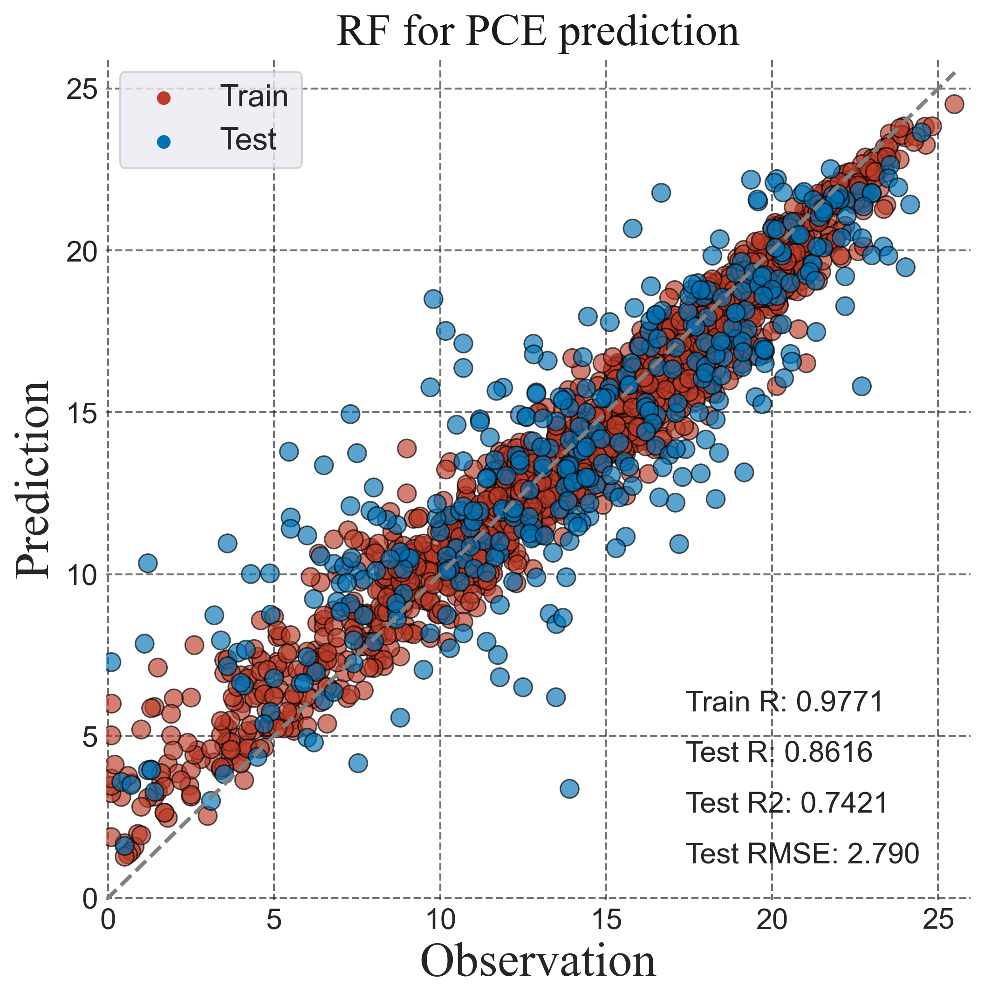

In [12]:
from sklearn.ensemble import RandomForestRegressor

rf_regressor = RandomForestRegressor(random_state=42)
rf_regressor.fit(X_train, y_train)
y_train_hat = rf_regressor.predict(X_train)
y_test_hat = rf_regressor.predict(X_test)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'RF',plot_height = 8, picname =  'RF')
# save_arrays_with_nan(y_train.values,y_train_hat,y_test.values,y_test_hat,'RFbefore')

In [13]:
from sklearn.model_selection import GridSearchCV

# RF
regressor = RandomForestRegressor()

params = {
    'n_estimators': [800, 1000, 1200],
    'max_depth': [10, 20, None],
    'min_samples_split': [3, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

grid_search = GridSearchCV(regressor, param_grid=params, cv=10, n_jobs = -1)
grid_search.fit(X_train, y_train)

print('Best parameters:', grid_search.best_params_)
print('Best score:', grid_search.best_score_)

Best parameters: {'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 800}
Best score: 0.6145240250219361


Train R2: 0.901253904315509
Train RMSE: 1.7169205956519036
Train MAE: 1.297400723927773
Test MAE: 2.132697156860018


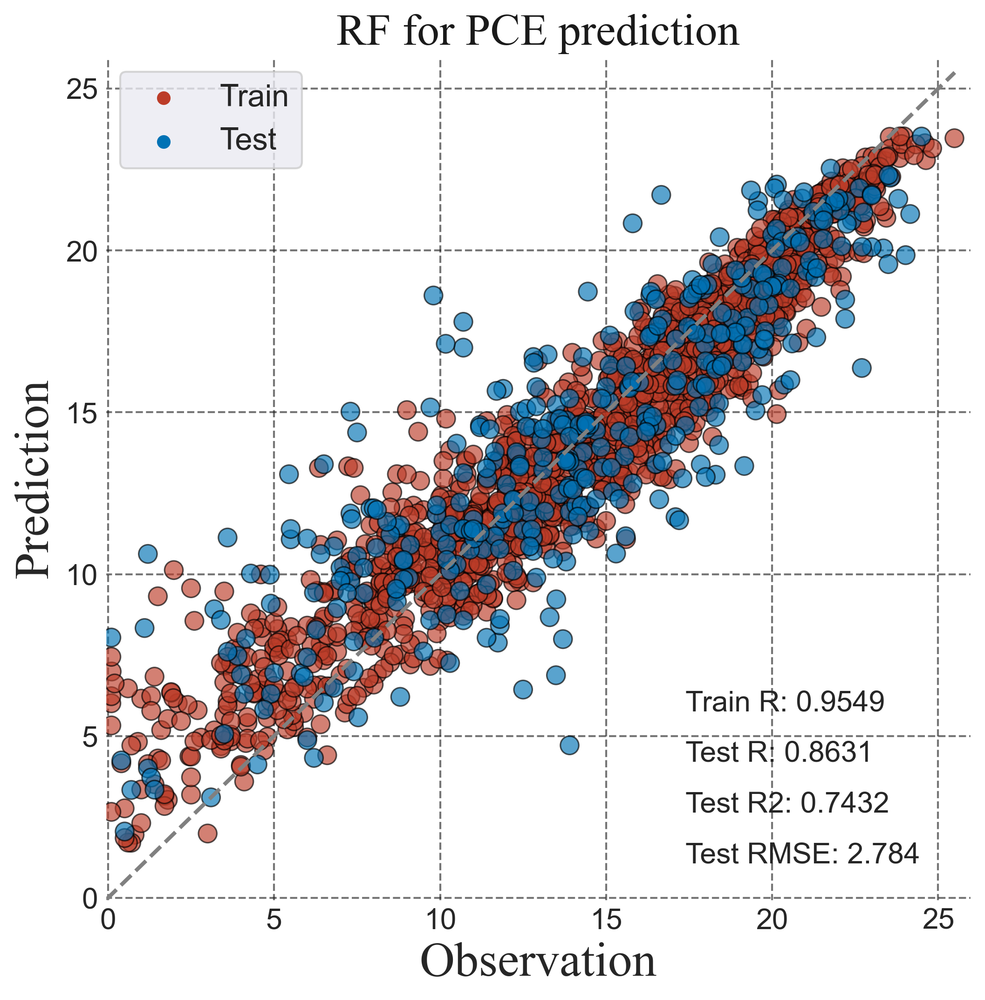

In [14]:
from sklearn.model_selection import train_test_split
from letsplot import myscatterplot
from sklearn.ensemble import RandomForestRegressor

rf_regressor = RandomForestRegressor(**{'max_depth': 20, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 800}, random_state=42)

rf_regressor.fit(X_train, y_train)
y_train_hat = rf_regressor.predict(X_train)
y_test_hat = rf_regressor.predict(X_test)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'RF',plot_height = 8, picname =  'RF')
# save_arrays_with_nan(y_train.values,y_train_hat,y_test.values,y_test_hat,'RF')

In [15]:
rf_regressor = RandomForestRegressor(**grid_search.best_params_)
rf_regressor.fit(X, Y)
# saveimportance(rf_regressor,'RF')

RandomForestRegressor(max_depth=20, min_samples_split=5, n_estimators=800)

## XGB

Train R2: 0.935379805945538
Train RMSE: 1.3889108568134056
Train MAE: 0.9553183370430549
Test MAE: 2.070936651445293


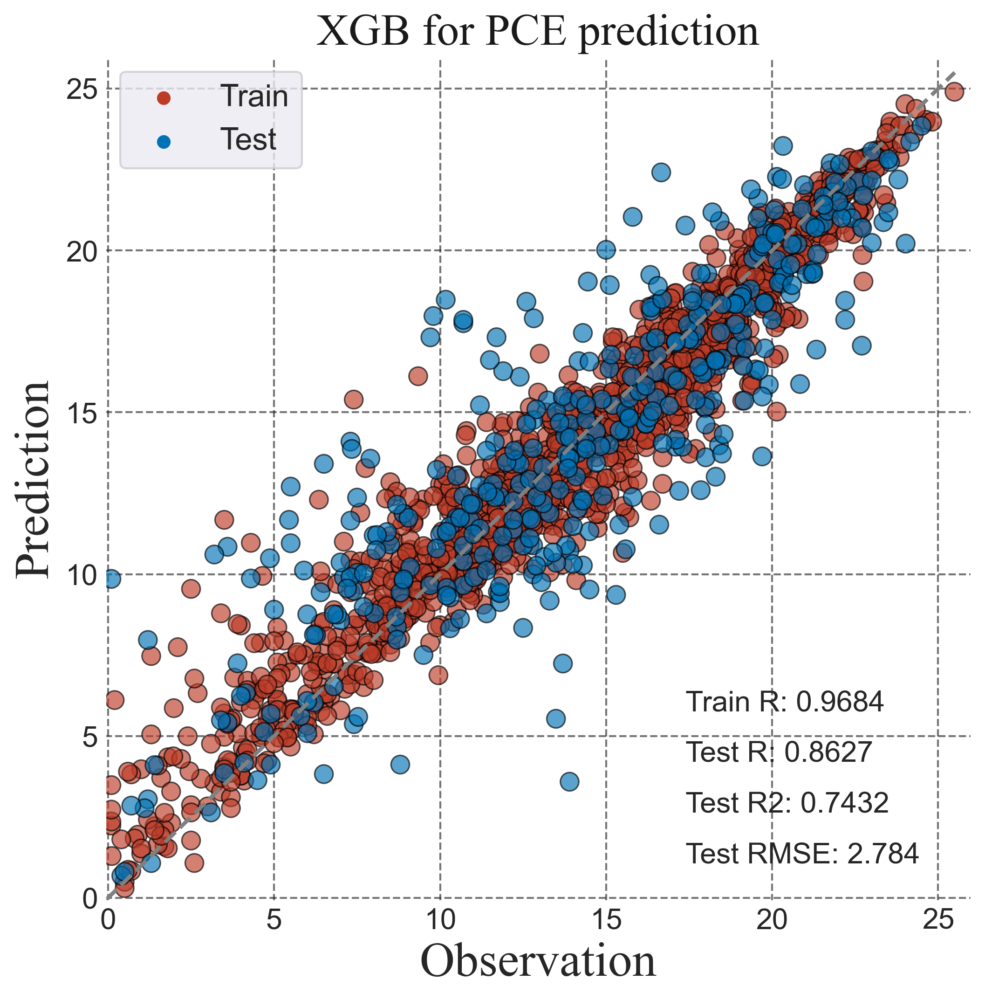

In [16]:
import xgboost as xgb
xgb_reg = xgb.XGBRegressor(random_state=42)
xgb_reg.fit(X_train, y_train)
y_train_hat = xgb_reg.predict(X_train)
y_test_hat = xgb_reg.predict(X_test)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'XGB',plot_height = 8, picname = 'XGB')
# save_arrays_with_nan(y_train.values,y_train_hat,y_test.values,y_test_hat,'XGB')

The base model's RMSE is: 3.2319226786563613
The best parameters are:  {'learning_rate': 0.05, 'max_depth': 7, 'n_estimators': 500}
The best score is:  3.1143791531641734
The best model's RMSE is: 3.1584593683296838
Train R2: 0.9393485313206373
Train RMSE: 1.3455842797033342
Train MAE: 0.9151743421015698
Test MAE: 2.021303857009007


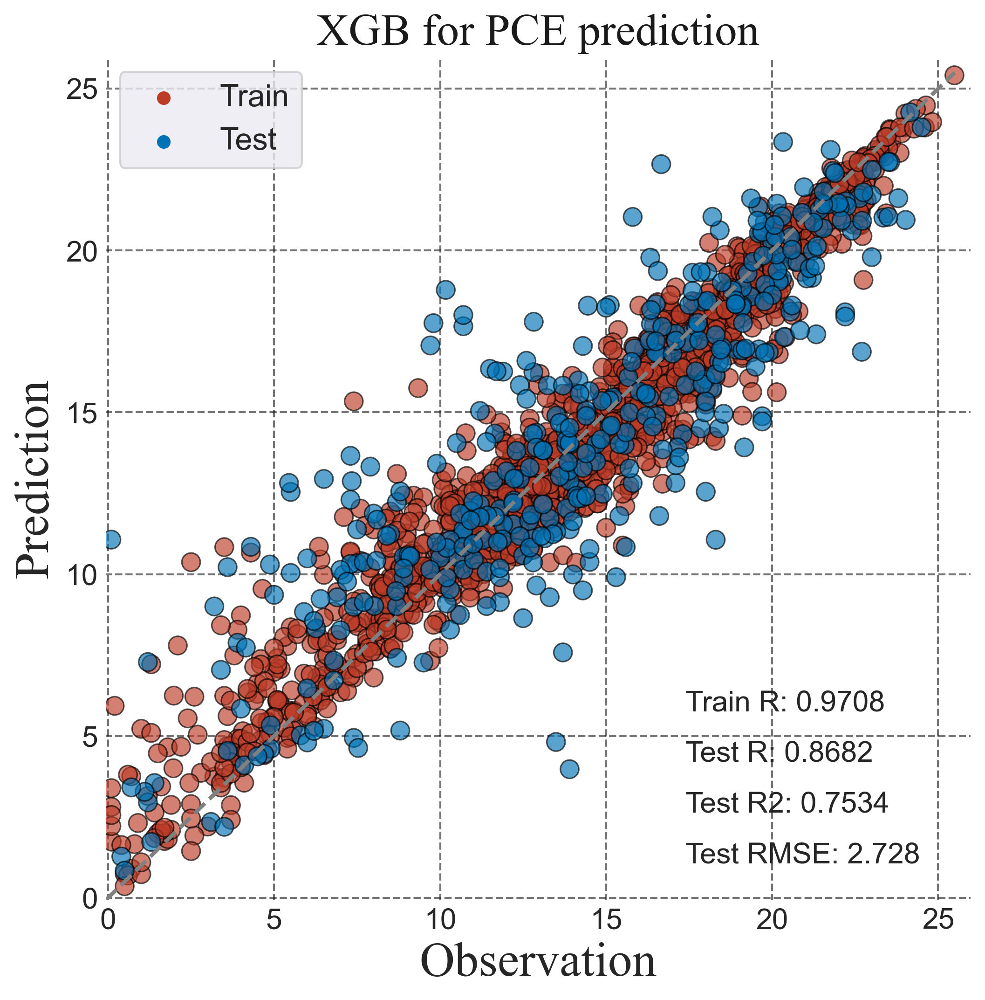

In [17]:
import xgboost as xgb
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score, GridSearchCV
import pandas as pd

# XGB Base RMSE
xgb_reg = xgb.XGBRegressor(random_state=42)
scores = cross_val_score(xgb_reg, X, Y, cv=5, scoring='neg_mean_squared_error')
rmse = (-scores.mean())**(1/2)
print("The base model's RMSE is:", rmse)

param_grid = {'n_estimators': [1000, 500, 700],
                'max_depth': [  7, 10 ],
                'learning_rate': [0.05, 0.1, 0.02]}
grid_search_XGb = GridSearchCV(xgb_reg, param_grid, cv=10, scoring='neg_mean_squared_error')
grid_search_XGb.fit(X, Y)

print("The best parameters are: ", grid_search_XGb.best_params_)
print("The best score is: ", (-grid_search_XGb.best_score_)**(1/2))

xgb_reg_best = xgb.XGBRegressor(**grid_search_XGb.best_params_, random_state=42)
scores_best = cross_val_score(xgb_reg_best, X, Y, cv=5, scoring='neg_mean_squared_error')
rmse_best = (-scores_best.mean())**(1/2)
print("The best model's RMSE is:", rmse_best)

xgb_reg_best = xgb.XGBRegressor(**grid_search_XGb.best_params_, random_state=42)

xgb_reg_best.fit(X_train, y_train)
y_train_hat = xgb_reg_best.predict(X_train)
y_test_hat = xgb_reg_best.predict(X_test)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'XGB',plot_height = 8, picname = 'XGB')
# save_arrays_with_nan(y_train.values,y_train_hat,y_test.values,y_test_hat,'XGB')

In [18]:
xgb_reg_best = xgb.XGBRegressor(**grid_search_XGb.best_params_, random_state=42)
xgb_reg_best.fit(X, Y)
# saveimportance(xgb_reg_best,'XGB')

XGBRegressor(base_score=0.5, booster='gbtree', callbacks=None,
             colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False,
             eval_metric=None, gamma=0, gpu_id=-1, grow_policy='depthwise',
             importance_type=None, interaction_constraints='',
             learning_rate=0.05, max_bin=256, max_cat_to_onehot=4,
             max_delta_step=0, max_depth=7, max_leaves=0, min_child_weight=1,
             missing=nan, monotone_constraints='()', n_estimators=500, n_jobs=0,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, ...)

## CB

In [19]:
catcol = ['ETL', 'ETL-2','HTL','HTL_additive', 'Perovskite_deposition_procedure',
       'Perovskite_deposition_method', 'Antisolvent', 'Precursor_solution',
        'ETL_Passivator', 'HTL_Passivator', 'Additive', 'Use_Cl',]

In [20]:
X_train[catcol] = X_train[catcol].astype('int')
X_test[catcol] = X_test[catcol].astype('int')

In [21]:
from catboost import CatBoostRegressor
import matplotlib.pyplot as plt
params = {
        'learning_rate':[0.07,0.08,0.09,0.1],
        'early_stopping_rounds':[2000,1500,1000],
        'depth':[5,7,9,10],
        }

cb_regressor = CatBoostRegressor(random_seed=42,cat_features=catcol,loss_function='RMSE',task_type="GPU",silent=True) 
grid_search_result = cb_regressor.grid_search(params, X=X_train, y=y_train, plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

bestTest = 3.243545943
bestIteration = 867
0:	loss: 3.2435459	best: 3.2435459 (0)	total: 16.1s	remaining: 12m 37s
bestTest = 3.240443928
bestIteration = 937
1:	loss: 3.2404439	best: 3.2404439 (1)	total: 32.4s	remaining: 12m 25s
bestTest = 3.225821478
bestIteration = 558
2:	loss: 3.2258215	best: 3.2258215 (2)	total: 50.3s	remaining: 12m 34s
bestTest = 3.264821285
bestIteration = 437
3:	loss: 3.2648213	best: 3.2258215 (2)	total: 1m 8s	remaining: 12m 31s
bestTest = 3.243545943
bestIteration = 867
4:	loss: 3.2435459	best: 3.2258215 (2)	total: 1m 24s	remaining: 12m 5s
bestTest = 3.240443928
bestIteration = 937
5:	loss: 3.2404439	best: 3.2258215 (2)	total: 1m 41s	remaining: 11m 52s
bestTest = 3.225821478
bestIteration = 558
6:	loss: 3.2258215	best: 3.2258215 (2)	total: 1m 59s	remaining: 11m 38s
bestTest = 3.264821285
bestIteration = 437
7:	loss: 3.2648213	best: 3.2258215 (2)	total: 2m 16s	remaining: 11m 24s
bestTest = 3.243545943
bestIteration = 867
8:	loss: 3.2435459	best: 3.2258215 (2)	tot

Train R2: 0.7381652320434786
Train RMSE: 2.795785839523166
Train MAE: 2.1388187614163185
Test MAE: 2.172662903188371


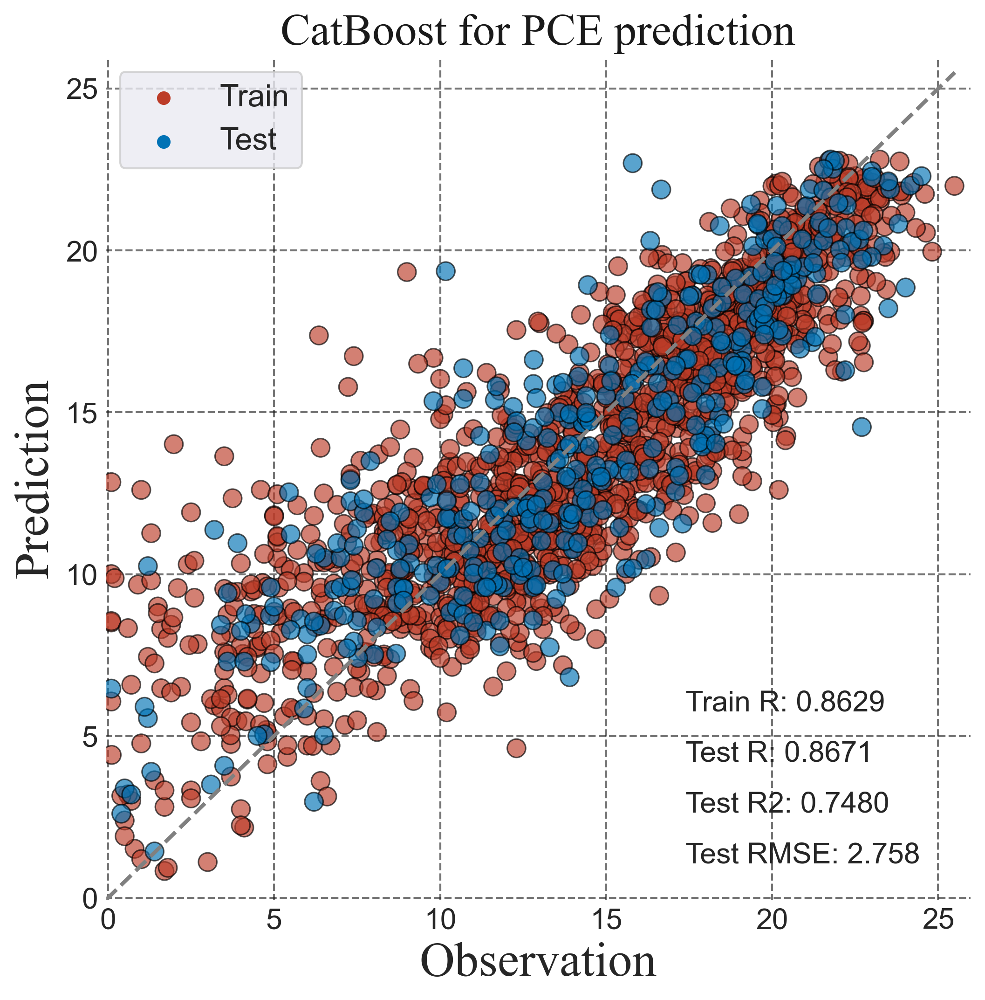

In [22]:
from catboost import CatBoostRegressor
cb_regressor = CatBoostRegressor(cat_features=catcol,random_seed=42,task_type="GPU", silent=True)
cb_regressor.fit(X_train, y_train)
y_train_hat = cb_regressor.predict(X_train)
y_test_hat = cb_regressor.predict(X_test)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'CatBoost',plot_height = 8, picname = 'CatBoost')
# save_arrays_with_nan(y_train.values,y_train_hat,y_test.values,y_test_hat,'CBbefore')

Train R2: 0.8803932864265255
Train RMSE: 1.8895919169516195
Train MAE: 1.3637991725423777
Test MAE: 2.0775143578616313


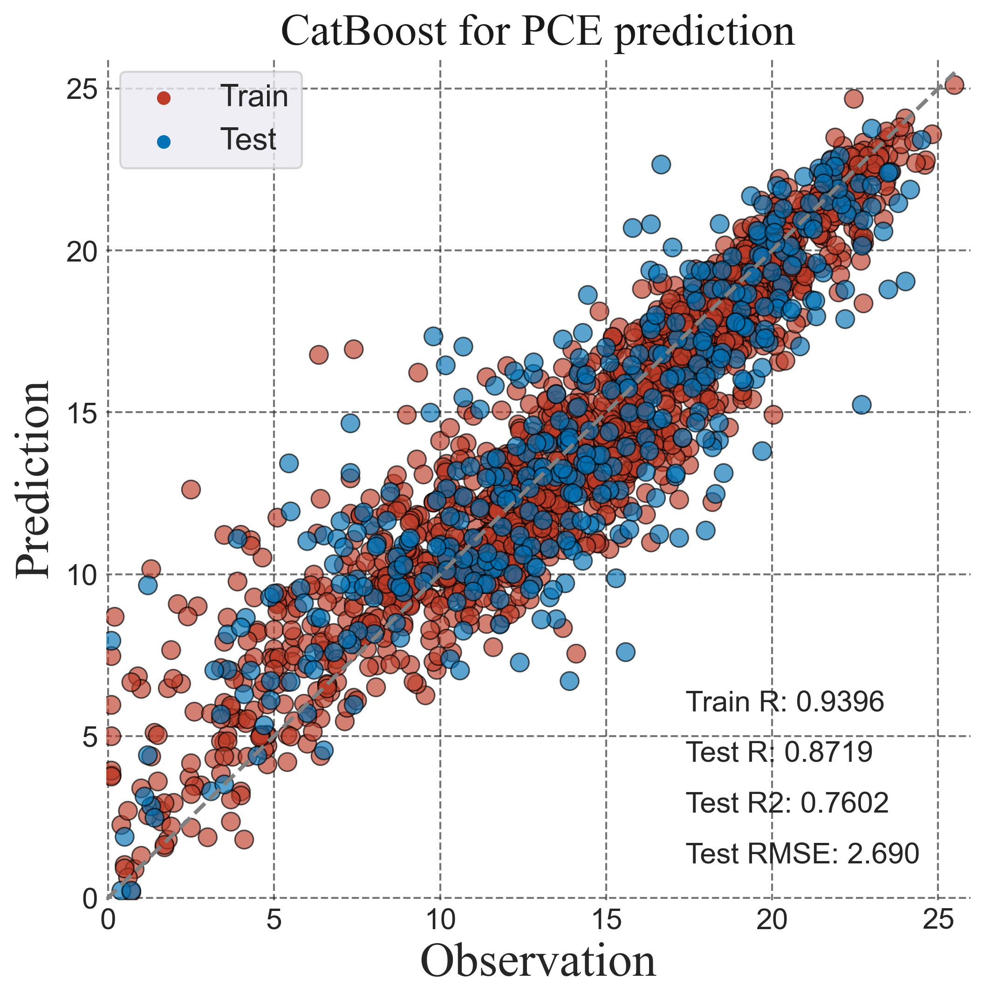

In [23]:
from catboost import CatBoostRegressor
cb_regressor = CatBoostRegressor(**{'boosting_type': 'Ordered','one_hot_max_size':255 ,'depth': 7,'iterations': 5000, 'l2_leaf_reg': 3, 'learning_rate': 0.09,'loss_function': 'RMSE'},
                                 cat_features=catcol,early_stopping_rounds=1500,random_seed=42,task_type="GPU", silent=True)
cb_regressor.fit(X_train, y_train)
y_train_hat = cb_regressor.predict(X_train)
y_test_hat = cb_regressor.predict(X_test)

myscatterplot(y_train,y_train_hat,y_test,y_test_hat,'CatBoost',plot_height = 8, picname = 'CatBoost')
# save_arrays_with_nan(y_train.values,y_train_hat,y_test.values,y_test_hat,'CB')

In [24]:
cb_regressor = CatBoostRegressor(**{'boosting_type': 'Ordered','one_hot_max_size':255 ,'depth': 7,'iterations': 5000, 'l2_leaf_reg': 3, 'learning_rate': 0.08,'loss_function': 'RMSE'},
                                 cat_features=catcol,early_stopping_rounds=1000,random_seed=42,task_type="GPU", silent=True)
cb_regressor.fit(X, Y)
# saveimportance(cb_regressor,'CB')

## SHAP

In [25]:
import shap
import pandas as pd
import matplotlib.pyplot as plt

explainer_cb = shap.TreeExplainer(cb_regressor)  
shap_values_cb = explainer_cb.shap_values(X)

In [26]:
explainer_xgb = shap.TreeExplainer(xgb_reg_best) 
shap_values_xgb = explainer_xgb.shap_values(X)

ntree_limit is deprecated, use `iteration_range` or model slicing instead.


In [27]:
explainer_rf = shap.TreeExplainer(rf_regressor)  
shap_values_rf = explainer_rf.shap_values(X)

In [28]:
explainer_lgbm = shap.TreeExplainer(lgbm)  
shap_values_lgbm = explainer_lgbm.shap_values(X)

In [29]:
stacked_arrays = np.stack([shap_values_cb, shap_values_xgb, shap_values_rf, shap_values_lgbm])

average_shap_values = np.mean(stacked_arrays, axis=0)
average_shap_values

array([[ 0.2977214 ,  0.006573  ,  0.00432147, ...,  0.05897429,
         0.18436313, -0.40789006],
       [ 0.20648321, -0.11003882, -0.01690531, ...,  0.05412919,
        -0.03935477, -1.08116029],
       [-0.83571735, -0.3726324 , -0.14638939, ...,  0.0361863 ,
         0.06321017,  0.29421864],
       ...,
       [ 0.72758962,  0.0268189 , -0.00497013, ..., -0.19722364,
         0.21772852, -0.3857634 ],
       [-0.53733637, -0.13648236, -0.01002504, ...,  0.03337037,
         0.07175579,  0.22973669],
       [-0.65140994, -0.29540291, -0.02724763, ...,  0.08548988,
         0.09197169,  0.34010535]])

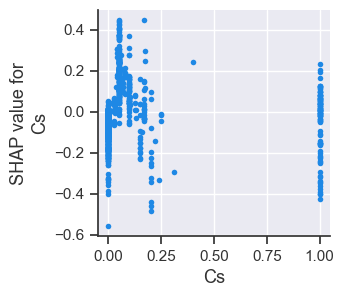

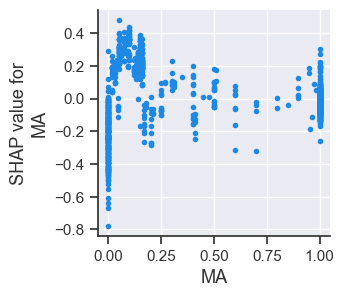

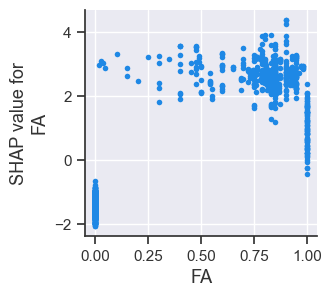

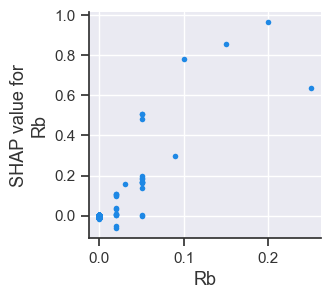

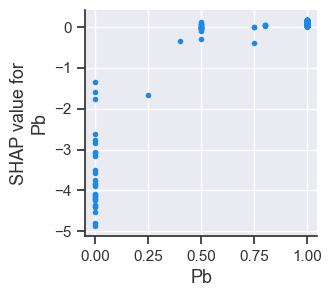

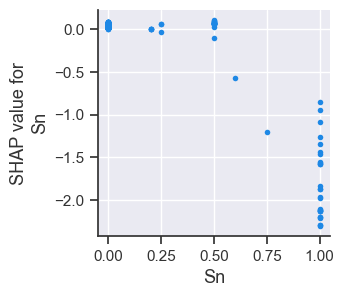

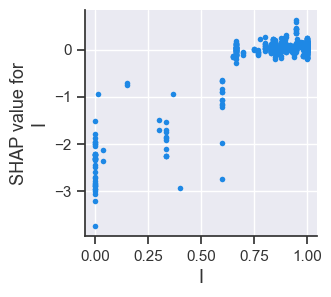

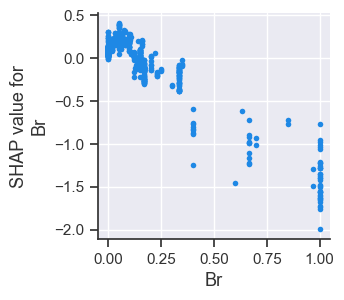

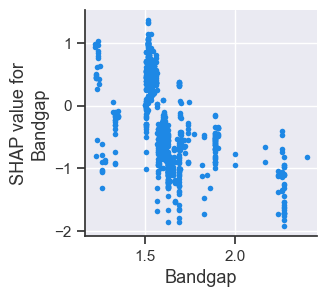

In [30]:
import pandas as pd
import shap
import matplotlib.pyplot as plt

df_X = pd.DataFrame(X)
plt.rcParams['font.sans-serif'] = ["Arial"]
data_dfs = [] 

for name in df_X.columns[12:]:
    fig, ax = plt.subplots(1, 1, figsize=(3, 3), dpi=100)
    ax.set_ylabel('SHAP value',)
    shap.dependence_plot(name, average_shap_values, X, display_features=X, interaction_index=None, ax=ax, show=False)
    
    scatter_data = ax.collections[0].get_offsets()    

    data_single_df = pd.DataFrame(scatter_data, columns=['{}_Feature_Value'.format(name), '{}_SHAP_Value'.format(name)])
    data_dfs.append(data_single_df)  

data_df = pd.concat(data_dfs, axis=1)

In [31]:
# data_df.to_csv("SHAPavg.csv")
data_df

,Cs_Feature_Value,Cs_SHAP_Value,MA_Feature_Value,MA_SHAP_Value,FA_Feature_Value,FA_SHAP_Value,Rb_Feature_Value,Rb_SHAP_Value,Pb_Feature_Value,Pb_SHAP_Value,Sn_Feature_Value,Sn_SHAP_Value,I_Feature_Value,I_SHAP_Value,Br_Feature_Value,Br_SHAP_Value,Bandgap_Feature_Value,Bandgap_SHAP_Value
0,0.00,-0.055945,1.0,-0.012048,0.7885,2.679096,0.0,-0.005042,1.0,0.083060,0.0,0.030435,1.00,0.111748,1.000000,-1.764924,1.686143,-0.673010
1,0.00,-0.020525,1.0,0.002848,0.5400,2.725197,0.0,-0.004171,1.0,0.046871,0.0,0.032437,1.00,0.113453,0.150000,0.023259,1.888930,-0.553658
2,0.05,0.097857,1.0,-0.018328,0.8300,2.153501,0.0,-0.006173,1.0,0.037016,0.0,0.024487,1.00,0.076238,0.000000,0.064178,1.530114,0.280747
3,0.00,-0.026635,1.0,-0.036571,0.0000,-1.730862,0.0,-0.003530,1.0,0.078778,0.0,0.027018,1.00,0.102037,0.000000,0.088455,1.530114,0.287931
4,0.00,-0.067150,1.0,-0.021450,0.9000,2.757117,0.0,0.001399,1.0,0.051200,0.0,0.045688,0.83,0.014300,0.000000,0.079286,1.530114,0.188972
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1863,0.00,-0.049416,0.0,-0.110127,0.0000,-1.001943,0.0,-0.005089,1.0,0.051065,0.0,0.046088,1.00,0.054076,0.333333,-0.359492,1.572768,-0.941609
1864,0.00,-0.011283,1.0,0.012192,0.8300,1.650928,0.0,-0.004567,1.0,0.061230,0.0,0.050282,1.00,0.072906,0.000000,0.122651,1.530114,0.329702
1865,0.00,-0.557184,1.0,0.036650,0.8400,2.240552,0.0,-0.004081,1.0,0.083075,0.5,0.065025,1.00,-0.042771,0.020000,0.140869,1.519563,0.717741
1866,0.05,0.187305,0.0,-0.283251,0.0000,-1.270077,0.0,-0.004202,1.0,0.055093,0.0,0.027025,1.00,0.120924,0.000000,0.105496,1.530114,0.306317
